In [97]:
import torch
import torch.nn as nn
import torch.optim as optim
from torchvision import datasets, transforms, models
import os


In [115]:
# Define data transformations for data augmentation and normalization
data_transforms = {
    'train': transforms.Compose([
        #lets see if this is even necessary or not
        transforms.RandomResizedCrop(640),
        transforms.ToTensor(),
        transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
    ]),
    'val': transforms.Compose([
        transforms.Resize(640),
        #transforms.CenterCrop(640),
        transforms.ToTensor(),
        transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
    ]),
}



In [116]:
# Define the data directory
data_dir = 'dataset'

# Create data loaders
image_datasets = {x: datasets.ImageFolder(os.path.join(data_dir, x), data_transforms[x]) for x in ['train', 'val']}
#image_datasets

In [118]:
dataloaders = {x: torch.utils.data.DataLoader(image_datasets[x], batch_size=4, shuffle=True, num_workers=4) for x in ['train', 'val']}
dataset_sizes = {x: len(image_datasets[x]) for x in ['train', 'val']}
print(dataset_sizes)

class_names = image_datasets['train'].classes
class_names

{'train': 372, 'val': 420}


['left', 'right']

In [119]:
# Load the pre-trained ResNet-18 model
model = models.resnet18(pretrained=True)

# Freeze all layers except the final classification layer
for name, param in model.named_parameters():
    if "fc" in name:  # Unfreeze the final classification layer
        param.requires_grad = True
    else:
        param.requires_grad = False

# Define the loss function and optimizer
criterion = nn.CrossEntropyLoss()
optimizer = optim.SGD(model.parameters(), lr=0.001, momentum=0.9)  # Use all parameters


# Move the model to the GPU if available
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
model = model.to(device)


In [120]:
# Training loop
num_epochs = 10
for epoch in range(num_epochs):
    for phase in ['train', 'val']:
        if phase == 'train':
            model.train()
        else:
            model.eval()

        running_loss = 0.0
        running_corrects = 0

        for inputs, labels in dataloaders[phase]:
            inputs = inputs.to(device)
            labels = labels.to(device)

            optimizer.zero_grad()

            with torch.set_grad_enabled(phase == 'train'):
                outputs = model(inputs)
                _, preds = torch.max(outputs, 1)
                loss = criterion(outputs, labels)

                if phase == 'train':
                    loss.backward()
                    optimizer.step()

            running_loss += loss.item() * inputs.size(0)
            running_corrects += torch.sum(preds == labels.data)

        epoch_loss = running_loss / dataset_sizes[phase]
        epoch_acc = running_corrects.double() / dataset_sizes[phase]

        print(f'{phase} Loss: {epoch_loss:.4f} Acc: {epoch_acc:.4f}')

print("Training complete!")


train Loss: 1.4036 Acc: 0.4677
val Loss: 0.7887 Acc: 0.5429
train Loss: 0.9322 Acc: 0.5242
val Loss: 0.9663 Acc: 0.5238
train Loss: 0.7720 Acc: 0.5323
val Loss: 0.6811 Acc: 0.5595
train Loss: 0.7063 Acc: 0.6237
val Loss: 0.6880 Acc: 0.5857
train Loss: 0.7968 Acc: 0.5780
val Loss: 0.9715 Acc: 0.5238
train Loss: 0.8110 Acc: 0.5591
val Loss: 0.8250 Acc: 0.5310
train Loss: 0.7354 Acc: 0.5941
val Loss: 1.1937 Acc: 0.4833
train Loss: 0.7387 Acc: 0.6156
val Loss: 1.1065 Acc: 0.5262
train Loss: 0.7648 Acc: 0.5941
val Loss: 0.7139 Acc: 0.5929
train Loss: 0.7217 Acc: 0.6102
val Loss: 0.7319 Acc: 0.5833
Training complete!


In [121]:

# Save the model
torch.save(model.state_dict(), 'arrow_classification_model_V5.pth')


# Classification on Unseen Image

To use the saved model to classify unseen images, you need to load the model and then apply it to the new images for inference.

In [122]:
import torch
from torchvision import models, transforms
from PIL import Image

# Load the saved model
model = models.resnet18(pretrained=True)
model.fc = nn.Linear(model.fc.in_features, 1000)  # Adjust to match the original model's output units
model.load_state_dict(torch.load('arrow_classification_model_V5.pth'))
model.eval()

# Create a new model with the correct final layer
new_model = models.resnet18(pretrained=True)
new_model.fc = nn.Linear(new_model.fc.in_features, 2)  # Adjust to match the desired output units

# Copy the weights and biases from the loaded model to the new model
new_model.fc.weight.data = model.fc.weight.data[0:2]  # Copy only the first 2 output units
new_model.fc.bias.data = model.fc.bias.data[0:2]




C:\Users\Rafid\AppData\Local\Temp\ipykernel_6344\3043868423.py:8: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load('arrow_classification_model_

Prepare your new image for classification. You should use the same data transformations you used during training. Here's an example of how to prepare an image for inference:

In [81]:
# Load and preprocess the unseen image
image_path = 'test_arrow_8.jpg'  # Replace with the path to your image
image = Image.open(image_path)
preprocess = transforms.Compose([
    transforms.Resize(256),
    transforms.CenterCrop(224),
    transforms.ToTensor(),
    transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
])
input_tensor = preprocess(image)
input_batch = input_tensor.unsqueeze(0)  # Add a batch dimension


Perform inference using the model:

In [82]:
# Perform inference
with torch.no_grad():
    output = model(input_batch)

# Get the predicted class
_, predicted_class = output.max(1)

# Map the predicted class to the class name
class_names = ['left', 'right']  # Make sure these class names match your training data
predicted_class_name = class_names[predicted_class.item()]

print(f'The predicted class is: {predicted_class_name}')


The predicted class is: left


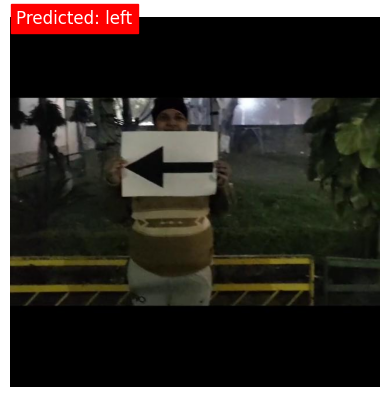

In [83]:
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image

# Display the image with the predicted class name
image = np.array(image)
plt.imshow(image)
plt.axis('off')
plt.text(10, 10, f'Predicted: {predicted_class_name}', fontsize=12, color='white', backgroundcolor='red')
plt.show()

In [123]:

import numpy as np
import matplotlib.pyplot as plt
from PIL import Image


# Set the path to the folder containing the test images
test_folder = 'test'  # Replace with the correct path to your folder

# Load the model (assuming your model is already loaded and ready)
# model = ...

# Define the class names (ensure this matches your training classes)
class_names = ['left', 'right']  # Adjust this list based on your model's classes

# Preprocessing transformations
preprocess = transforms.Compose([
    transforms.Resize(256),
    transforms.CenterCrop(224),
    transforms.ToTensor(),
    transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
])

# Load all images in the folder
image_paths = [os.path.join(test_folder, img_name) for img_name in os.listdir(test_folder) if img_name.endswith(('.jpg', '.png'))]

# Perform inference on each image and store the results
predictions = []
images = []

for image_path in image_paths:
    image = Image.open(image_path)
    input_tensor = preprocess(image)
    input_batch = input_tensor.unsqueeze(0)  # Add a batch dimension
    
    with torch.no_grad():
        output = model(input_batch)
    _, predicted_class = output.max(1)
    predicted_class_name = class_names[predicted_class.item()]
    
    predictions.append(predicted_class_name)
    images.append(np.array(image))

# Display the images in a grid format
n_images = len(images)
n_cols = 3  # Number of columns in the grid
n_rows = int(np.ceil(n_images / n_cols))

plt.figure(figsize=(100, 100))
for i in range(n_images):
    plt.subplot(n_rows, n_cols, i + 1)
    plt.imshow(images[i])
    plt.axis('off')
    plt.title(predictions[i])

plt.tight_layout()
plt.show()
